In [1]:
import numpy as np
from numpy import inf
import matplotlib.pyplot as plt
from matplotlib import cm
%matplotlib inline
from os import walk    
import traceback
import sys


from skimage import io
from skimage.feature import canny
from skimage.measure import LineModelND, ransac
from skimage.transform import hough_line, hough_line_peaks, ProjectiveTransform, warp, rescale

In [2]:
IN_COLAB = 'google.colab' in sys.modules
if IN_COLAB:
    !git clone https://github.com/Akuva2001/IITP_im_course_proj.git
    folder = "IITP_im_course_proj/images/"
else:
    folder = "images/"

In [3]:
filenames = next(walk(folder), (None, None, []))[2]
filenames

['im7.jpg',
 'im6.jpg',
 'im4.jpg',
 'im5.jpg',
 'im1.jpg',
 'im2.jpg',
 'im3.jpg',
 'im12.jpg',
 'im13.jpg',
 'im11.jpg',
 'im10.jpg',
 'im8.jpg',
 'im14.jpg',
 'im9.jpg']

In [4]:
def get_line(a, b, x_lim, y_lim=None):
    x = np.linspace(*x_lim)
    y = a * x + b
    if y_lim is not None:
        y = y[y>=y_lim[0]]
        y = y[y<=y_lim[1]]
    return x, y

def hough_thetaro_to_ab(theta, ro):
    a = inf if np.tan(theta) == 0 else -1 /np.tan(theta)
    b = inf if np.sin(theta)==0 else ro / np.sin(theta)
    return a, b

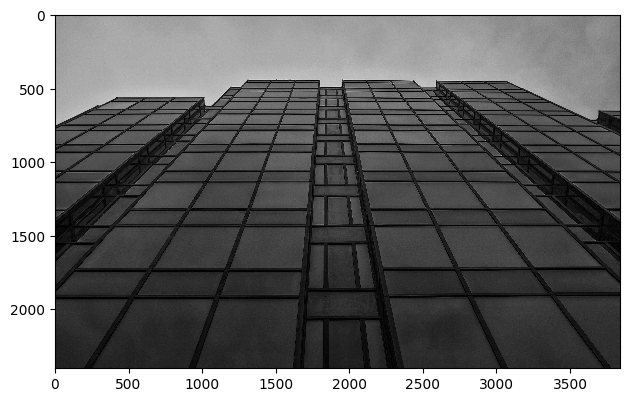

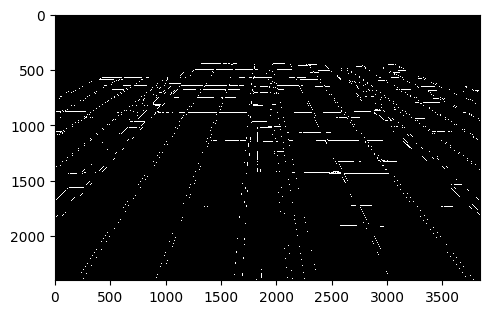

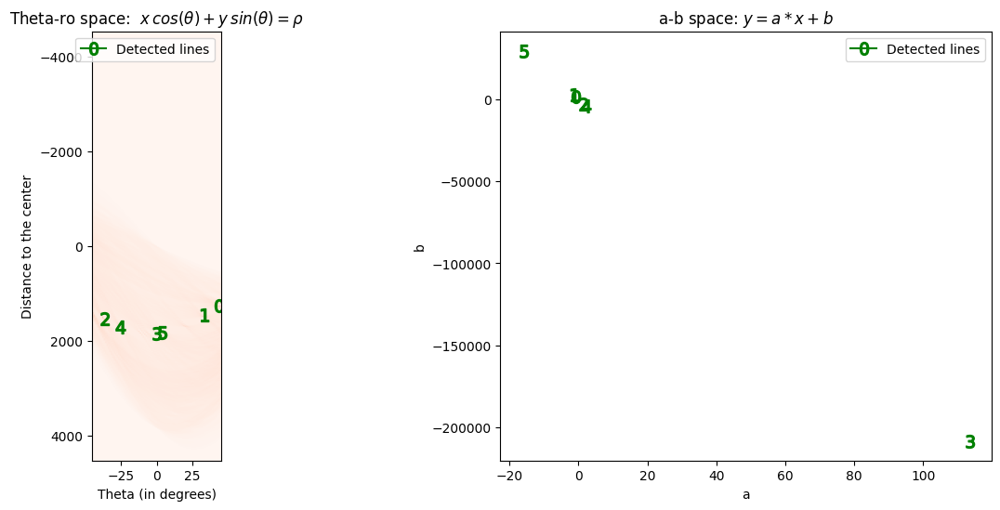

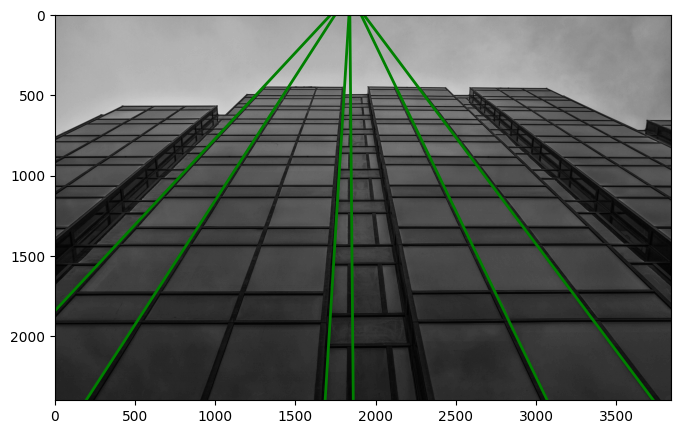

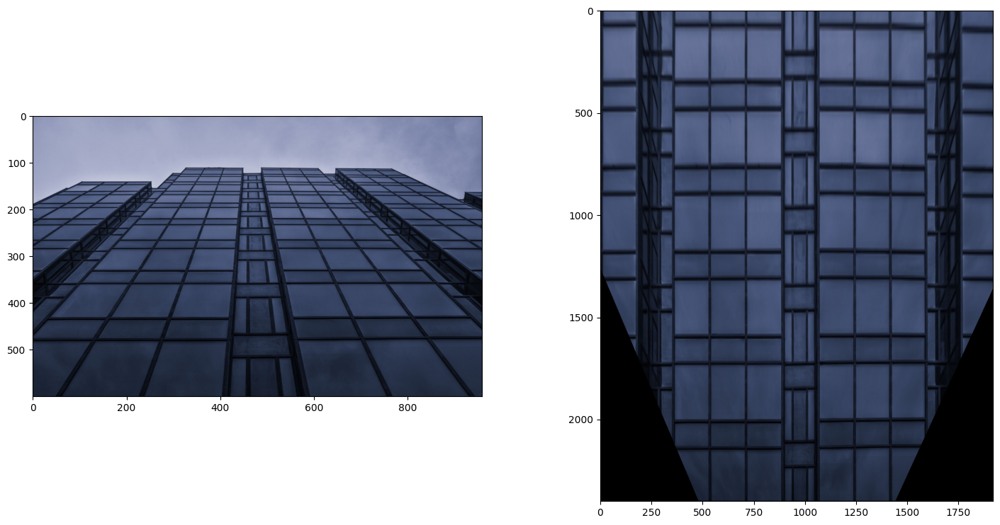

...

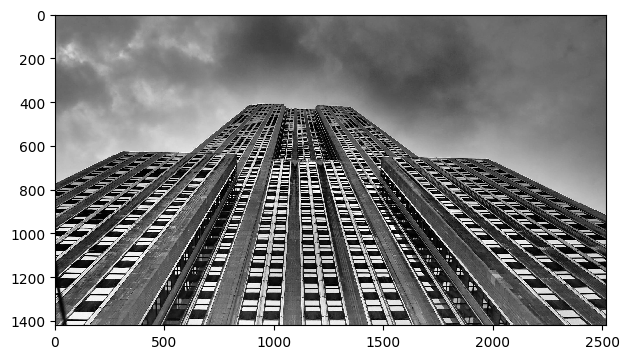

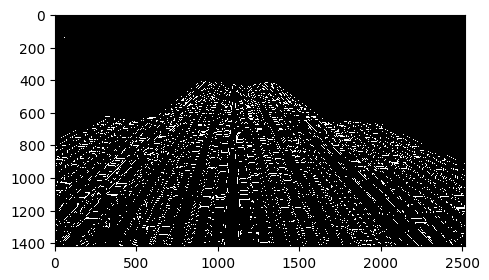

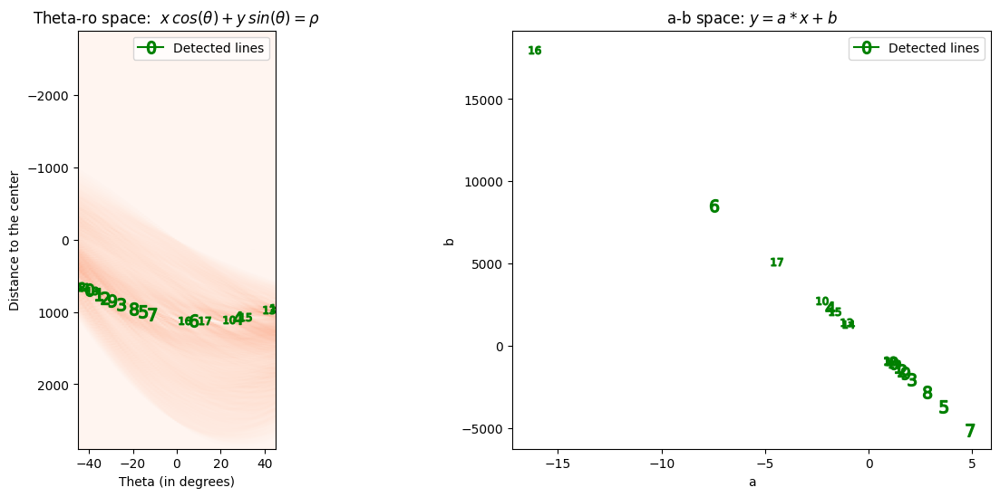

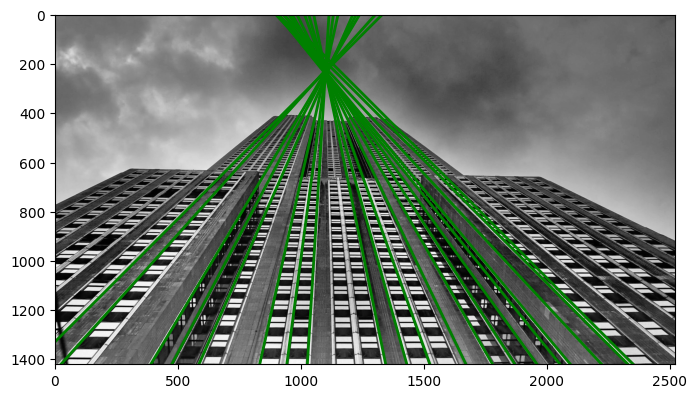

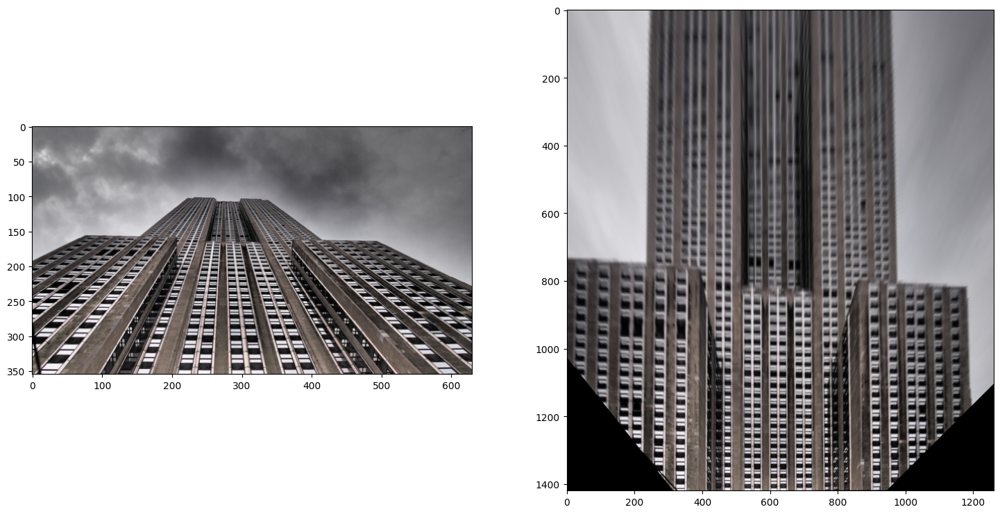

In [5]:
plotsize = 5
min_detected_angle = np.pi/4
x_shift = 0.5
high_mul = 4
res_downscale = 0.25
high_horizon = 0.4
for fname in filenames:
    image = io.imread(folder + fname, as_gray=True, plugin='matplotlib')
    io.imshow(image);
    edges = canny(image, sigma=2)

    plt.figure(figsize=[plotsize, plotsize])
    io.imshow(edges);
    plt.show()
    h_all, theta_all, ro_all = hough_line(edges, theta=np.linspace(-min_detected_angle, min_detected_angle, 90))
    h_selected, theta_selected, ro_selected = hough_line_peaks(h_all, theta_all, ro_all, min_distance=9, min_angle=1, 
                                                               threshold=None, num_peaks=20)
    y_max, x_max = edges.shape

    
    ab_selected = np.array(
        [hough_thetaro_to_ab(theta, ro)
         for theta, ro in zip(theta_selected, ro_selected)]# if theta > -60 and theta <60]
    )
    
    model, inliers = ransac(ab_selected, LineModelND, min_samples=min(5, len(ab_selected)-1), residual_threshold=0.05)
    fig, ax = plt.subplots(1, 2, figsize=(15, 6))
    ax[0].imshow(h_all, cmap=cm.Reds, aspect=0.033,
                 extent=[np.rad2deg(theta_all.min()), np.rad2deg(theta_all.max()), 
                                    ro_all.max(), ro_all.min()])

    for i, (theta, ro) in enumerate(zip(theta_selected, ro_selected)):
        marker = '${}$'.format(i)
        color = 'g' if inliers[i] else 'r'
        ax[0].plot(np.rad2deg(theta), ro, color, marker=marker, ms=10)
        a, b = hough_thetaro_to_ab(theta, ro)
        ax[1].plot(a, b, color, marker=marker, ms=10)


    ax[0].set_title(r'Theta-ro space:  $x\,cos(\theta)+ y\,sin(\theta)=\rho$')
    ax[0].set_xlabel('Theta (in degrees)')
    ax[0].set_ylabel('Distance to the center')
    ax[0].legend(['Detected lines'])

    ax[1].set_title(r'a-b space: $y = a*x + b$')
    ax[1].legend(['Detected lines'])
    ax[1].set_xlabel('a')
    ax[1].set_ylabel('b')
    plt.show()
    plt.figure(figsize = (8,5))
    plt.imshow(image, cmap=cm.gray)
    for i, (theta, ro) in enumerate(zip(theta_selected, ro_selected)):
        a, b = hough_thetaro_to_ab(theta, ro)
        color = 'g' if inliers[i] else 'r'
        plt.plot(*get_line(a, b, (0, x_max)), color, lw=2)

    plt.xlim([0, x_max])
    plt.ylim([y_max, 0])
    plt.show()
    lines_ab_final = ab_selected[inliers]
    points_current = []
    points_desired = []

    for i, ab in enumerate(lines_ab_final):
        x_0 = (y_max*high_horizon - ab[1]) / ab[0]
        x_1 = (y_max - ab[1]) / ab[0]
        points_current.append([x_1, y_max])
        points_desired.append([x_1+int(x_max*x_shift), y_max*high_mul])
        points_current.append([x_0, y_max*high_horizon])
        points_desired.append([x_1+int(x_max*x_shift), y_max*high_horizon*high_mul])

    points_current = np.array(points_current)*res_downscale
    points_desired = np.array(points_desired)*res_downscale
    tform = ProjectiveTransform()
    tform.estimate(points_desired, points_current)
    
    image_rgb = io.imread(folder+fname, plugin='matplotlib')
    image_scaled = rescale(image_rgb, res_downscale, channel_axis=2)
    fig, ax = plt.subplots(1, 2, figsize=(18, 9))
    ax[0].imshow(image_scaled)
    ax[1].imshow(warp(image_scaled, tform, clip=False, output_shape=(int(y_max*high_mul*res_downscale), int((x_max+int(x_max*x_shift)*2)*res_downscale))))
    plt.show()